!pip install hyperopt

# Custom models and its evaluation

In [1]:
import numpy as np
from sklearn import datasets

import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
plt.rcParams['figure.figsize'] = [20,8]

## Get data

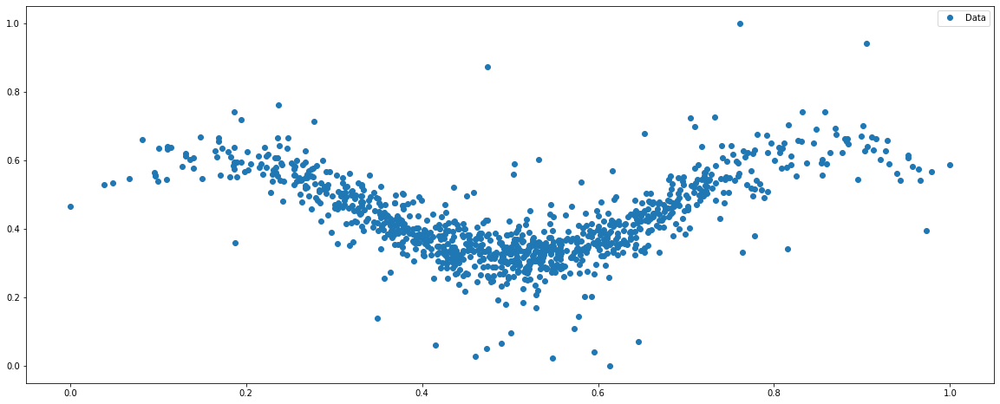

In [3]:
# Generate nonlinear data with outliers.
# Don't hesitate to change the generation parameters, method and data itself! Observe, how it changes results

n_samples = 1000
n_outliers = 100

X, y = datasets.make_regression(n_samples=n_samples, n_features=1,
                                      n_informative=1, noise=25,
                                      coef=False, random_state=1110)



# Replace first N samples with outliers

X[:n_outliers] = np.random.normal(size=(n_outliers, 1))
y[:n_outliers] = 100 * np.random.normal(size=n_outliers)

# Add non-linearity to data

y = y+100*X.T[0]*np.sin(X.T[0])

# Scale data to put in range [0,1] for stability.
# Check results if ignore it.
# See also sklearn User Guide (https://scikit-learn.org/stable/modules/preprocessing.html#scaling-features-to-a-range) and try another tools (Standartization, Normalization)
X = (X - X.min())/(X.max()-X.min())
y = (y - y.min())/(y.max()-y.min())


plt.plot(X, y, 'o', label = 'Data')
plt.legend()

In [4]:
# Add bias column to data
X_I = np.c_[np.ones_like(X), X]

## Define Model

In [5]:
def huber(delta,y_true, y_pred):
   y_true = np.asanyarray(y_true)
   y_pred = np.asanyarray(y_pred)
   assert len(y_true) == len(y_pred),"Target and Prediction arrays length should be equal"
   total_error= 0
   for i in range(len(y_pred)):
      if abs(y_true[i]-y_pred[i])<=delta:
         error=((y_true[i]-y_pred[i])**2)/2
      else:
         error = delta*abs(y_true[i]-y_pred[i]) - (delta**2)/2
      total_error += error 
   return np.mean(total_error)

In [6]:
def mape(y_true, y_pred):
    y_true = np.asanyarray(y_true)
    y_pred = np.asanyarray(y_pred)
    assert len(y_true) == len(y_pred), "Target and Prediction arrays length should be equal"
    
    if np.any(y_true==0):
        #print("Found zeroes in y_true. MAPE is undefined. Removing it from set.")
        idx = np.where(y_true==0)
        y_true = np.delete(y_true, idx)
        y_pred = np.delete(y_pred, idx)
        #print("%i samples deleted" %len(idx))
    
    mape_value = np.mean(np.abs((y_true - y_pred) / y_true)) * 100
    return mape_value

In [7]:
print('Error of random prediction: %.2f%%'%mape(y, np.random.random(len(y))) )
print('Error of random prediction Huber: %.2f%%'%huber(0.01 ,y, np.random.random(len(y))))

Error of random prediction: 76.81%
Error of random prediction Huber: 2.60%


In [8]:
def predict(X, theta):
    return np.dot(X, theta)

In [9]:
theta = np.random.random(len(X_I[0]))
print('Error of random model: %.2f%%'%mape(y, predict(X_I, theta)))
print('Error of random model Huber: %.2f%%'%huber( 0.01 ,y, predict(X_I, theta)))

Error of random model: 173.62%
Error of random model Huber: 5.93%


In [10]:
def objective_function(theta, X,y, loss_function=mape, delta = None, regularization = None, lam = 1/2):
  y_true = np.asanyarray(y)
  y_pred = predict(X, theta)
  if regularization:
    if(loss_function == huber):
      return loss_function(delta, y_true, y_pred) + regularization(theta,lam)
    else:
      return loss_function(y_true, y_pred) + regularization(theta,lam)
  else:
    if(loss_function == huber):
      return loss_function(delta, y_true, y_pred)
    else:
      return loss_function(y_true, y_pred)
     

In [11]:
def l1_reg(theta, lam = 1):
    return lam * np.sum(abs(theta))

def l2_reg(theta, lam = 1):
    return lam * np.sum(theta**2)

def elastic(theta, lam = 1):
    return l1_reg(theta,lam) + l2_reg(theta, lam)  

Visualize objective function surface

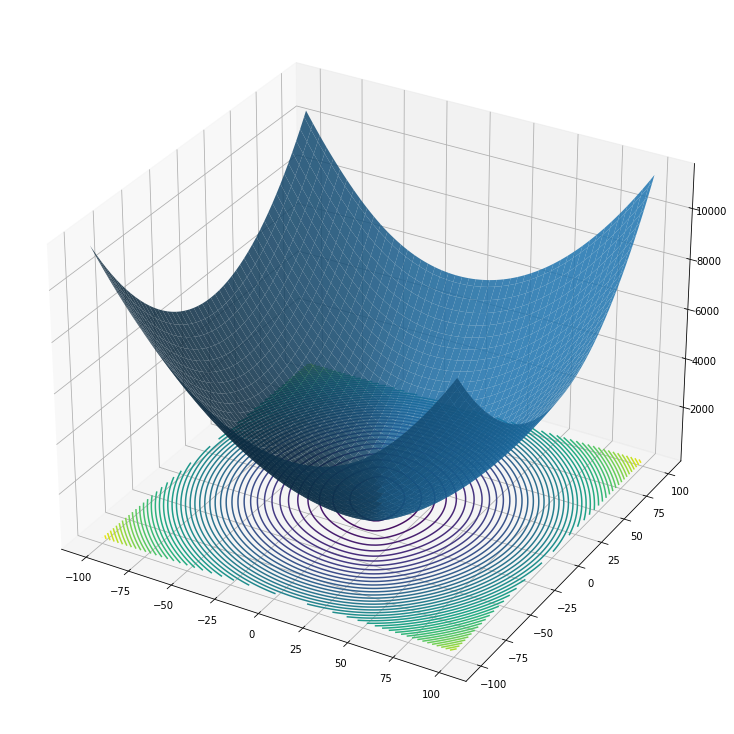

In [12]:
size = 100 # amount of tries for each parameter
limits = (-100,100) # range of values for each parameter
error = np.zeros((size,size)) # empty matrix of errors
for i,w in enumerate(np.linspace(*limits,size)): # for each theta[0] component
    for j,b in enumerate(np.linspace(*limits,size)): # for each theate[1] component
        error[i,j] = objective_function(np.array([b,w]), X_I, y,loss_function=huber,delta=0.01,regularization=l2_reg) # compute cost for each theta

# initialize figure
from mpl_toolkits.mplot3d import Axes3D
fig = plt.figure(figsize = (10,10))
ax = Axes3D(fig)

# create 2d array for each index 
K,L = np.meshgrid(np.linspace(*limits,size),np.linspace(*limits,size))

ax.plot_surface(K,L,Z = error, alpha = 0.85) # plot cost function surface in 3d
plt.contour(K,L,error,50, offset = 1) # plot cost function 2d-projection

## Train model

In [12]:
from scipy import optimize

In [14]:
theta_init = np.array([1]*X_I.shape[1]) # initial value of theta

result = optimize.minimize(
                           objective_function,  # function to optimize. Parameter to optimize should the first argument 
                           args=(X_I, y, huber,0.05), # other arguments of the function
                           x0 = theta_init,     # initial value of parameter to optimize
                           method='Powell',     # optimization method. Try also BFGS, Nelder-Mead, Powell, CG, TNC and others (see docs). Effectivnes can change dramatically!
                           options={}           # arguments of optimization method, like number of iterations, learning rate, etc.
                           )

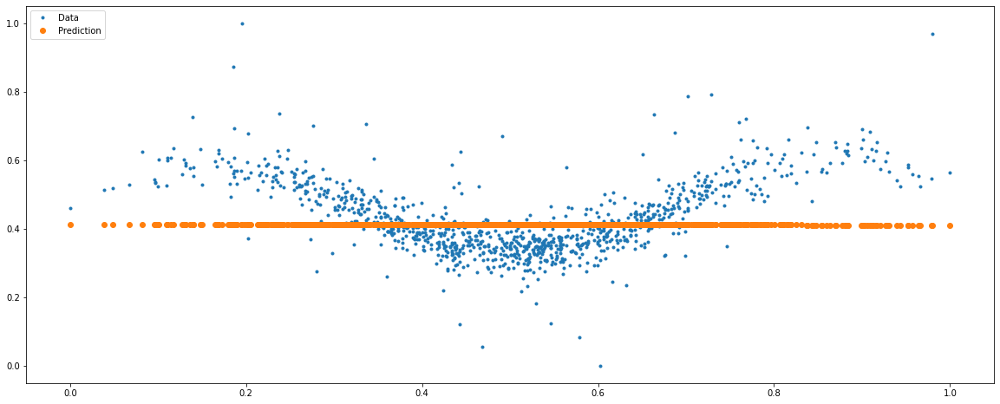

In [17]:
# Visualize result
theta = result.x
y_pred = predict(X_I, theta)
plt.plot(X, y, '.', label = 'Data')
plt.plot(X, y_pred, 'o', label = 'Prediction')
plt.legend()

In [62]:
# For further use, let's make universal function to train regression model with any objective and loss functions

def custom_regression(X, y, 
                      objective_function=objective_function, 
                      loss_function=huber,
                      delta=None,
                      regularization=None,
                      lam=1/2,
                      init = 1, 
                      verbose = True, 
                      iters = 10,
                      method_optim = 'CG'
                      ):
  
  theta_init = np.ones_like(X[0]) * init
  result = optimize.minimize(objective_function,
                             args=(X, y, loss_function, delta,regularization,lam), 
                             x0 = theta_init, 
                             method=method_optim, 
                             options={'maxiter': iters})
  theta = result['x']
  if verbose:
    print(result['fun'])
  return theta

## Add polynomial features

In [57]:
from sklearn.preprocessing import PolynomialFeatures

n = 10 # power of polynom
polynomial_features = PolynomialFeatures(degree=n,include_bias=True) # create instance of preprocessor
X_a = polynomial_features.fit_transform(X) # apply transformation
X_a.shape

(1000, 11)

In [58]:
theta = custom_regression(X_a, y, objective_function=objective_function, loss_function=huber, delta= 0.05 )

3.3276526599526943


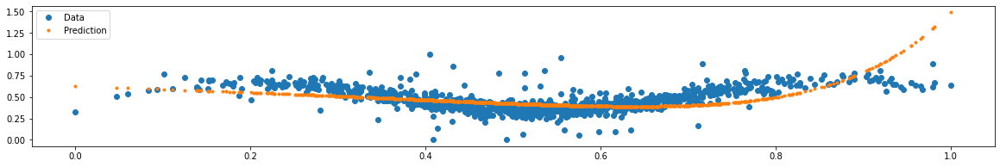

In [59]:
y_pred = predict(X_a, theta)
plt.plot(X, y, 'o', label = 'Data')
ax = plt.gca()
ax.autoscale(enable = True)
plt.plot(X, y_pred, '.', label = 'Prediction')
plt.legend()

In [60]:
degrees = [1,5,10,25,50,100,250,500]

In [13]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33)

0.5099243472719274
0.283221411774673
0.2534803201911168
0.24751975721850847
0.29582822790773056
0.4610440802729536
0.7737338242408011
0.9283145006868856
Wall time: 2min 7s


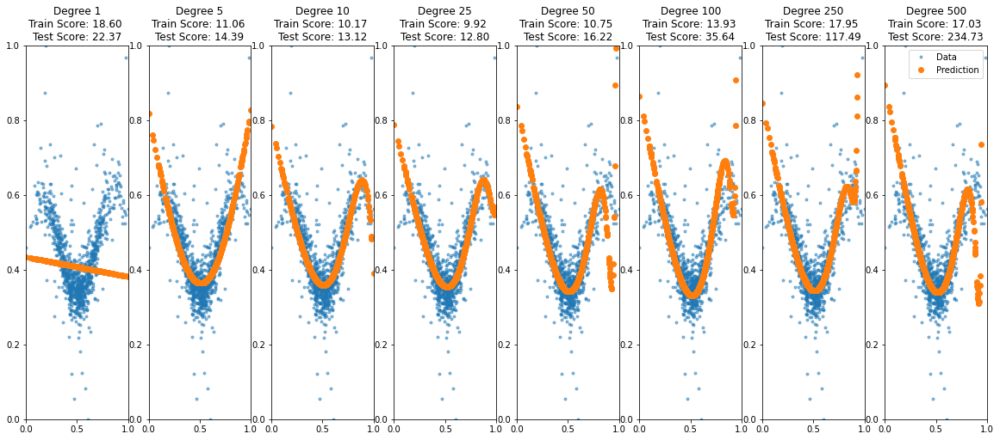

In [24]:
%%time
for i,n in enumerate(degrees):
  polynomial_features = PolynomialFeatures(degree=n,include_bias=True)
  
  X_all = polynomial_features.fit_transform(X)
  X_a_train = polynomial_features.fit_transform(X_train)
  X_a_test = polynomial_features.fit_transform(X_test)
  
  theta = custom_regression(X_a_train, y_train, objective_function=objective_function, loss_function=huber,regularization=l2_reg,lam=0.001,delta=0.01,iters = 50)
  y_pred_test = predict(X_a_test, theta)
  y_pred_train = predict(X_a_train, theta)
  test_score = objective_function(theta=theta, X=X_a_test, y=y_test, delta= 0.01, regularization = l2_reg, lam=0.001)
  train_score = objective_function(theta=theta, X=X_a_train, y=y_train, delta= 0.01, regularization = l2_reg, lam=0.001)
  
  y_pred = predict(X_all, theta)
  
  ax = plt.subplot(1, len(degrees), i + 1)
  ax.plot(X, y, '.', alpha = 0.5, label = 'Data')
  ax.autoscale(enable = False)
  ax.plot(X, y_pred, 'o', label = 'Prediction')
  plt.title("Degree %i\nTrain Score: %.2f \nTest Score: %.2f"%(degrees[i], train_score, test_score))
plt.legend()

## Evaluate result

In [14]:
from sklearn.model_selection import cross_val_score
from sklearn.pipeline import Pipeline
from sklearn.base import BaseEstimator, RegressorMixin, ClassifierMixin

In [63]:
class CustomRegression(BaseEstimator, RegressorMixin):                           
  def __init__(self, loss_function=huber, objective_function=objective_function,reguralization=None,lam=1/2, delta = 0.005, method_optim = 'CG'): # all arguments should have default values
    self.theta = None # we don't know shape of theta on this stage
    # just save all variables taken during call to internal variables
    self.loss_function = loss_function 
    self.objective_function = objective_function
    self.delta= delta
    self.reguralization = reguralization
    self.lam=lam
    self.method_optim=method_optim
    

  def predict(self, X):
    return predict(X, self.theta)
  
  def score(self, X, y):
    return self.objective_function(theta=self.theta, X=X,y=y,loss_function=self.loss_function,delta=self.delta,regularization = self.reguralization,lam=self.lam)
  
  def fit(self, X, y):
    if type(self.theta) == type(None):
      self.theta = np.ones_like(X[0])
    else:
      assert self.theta.shape == X[0].shape, "Model's shape doesn't fit input shape"
    self.theta = custom_regression(X, y, self.objective_function, self.loss_function, init = self.theta, verbose = False,delta= self.delta,lam=self.lam,method_optim=self.method_optim)
    return self.score(X, y)
  
  def fit_predict(self, X, y):
    self.fit(X,y)
    return self.predict(X)
     

In [64]:
degrees = [5,10,15,20,25,30]

OWN CROSS-VALIDATION FUNC

In [15]:
from sklearn.model_selection import KFold
from hyperopt import hp, fmin, tpe, Trials, STATUS_OK
from functools import partial
plt.rcParams["figure.figsize"] = (20,3)

In [82]:
def evaluate_metric(params,X_train,y_train,X_test, y_test,max_evals):
    polynomial_features = PolynomialFeatures(degree = 10) # create instance of transformer
    regression = CustomRegression(loss_function=huber)
    pipeline = Pipeline([("polynomial_features", polynomial_features), # augment data
                       ("regression", regression)])
    pipeline.set_params(**params)
    pipeline.fit(X_train, y_train)
    kf = KFold(n_splits=5, shuffle=True, random_state=1)
    scores = cross_val_score(pipeline, X_train, y_train, cv=kf)
    test_scores = pipeline.score(X_test, y_test)
    
    line_x = np.linspace(-0.1, 1.1, 1000).reshape(1000,1)
    line_y = pipeline.predict(line_x)
    ax = plt.subplot(1, 7, i + 1)
    ax.plot(X, y, '.', alpha = 0.5, label = 'Data')
    ax.autoscale(enable = False)
    ax.plot(line_x, line_y, '-', label = 'Prediction')
    plt.title("CV-Score: %.2f +- %.2f\nTest-Score: %.2f\nParams: regularization func: %s, regularization_lambda: %.2f\nHuber_delta: %.2f\npolynomial_features__degree: %i"%(scores.mean(),scores.std(),test_scores,pipeline.get_params()['regression__reguralization'].__name__,pipeline.get_params()['regression__lam'],pipeline.get_params()['regression__delta'],pipeline.get_params()['polynomial_features__degree']))
    plt.show()
    return  {'loss': scores.mean(), 'params': params,'status': STATUS_OK}

In [83]:
hyper_space = {'regression__delta': hp.uniform('delta', 0.01, 0.1),
               'regression__reguralization':  hp.choice('regularization function', [l1_reg,l2_reg,elastic]),
               'regression__lam': hp.uniform('lam', 1e-3, 1/2),
               'polynomial_features__degree': hp.choice('polynomial_features__degree', np.arange(5,26).tolist()),
               'regression__method_optim': hp.choice('method_optim', ['CG','TNC','BFGS'])
               }

In [86]:
import gc
gc.collect()

38897

  0%|          | 0/50 [00:00<?, ?trial/s, best loss=?]

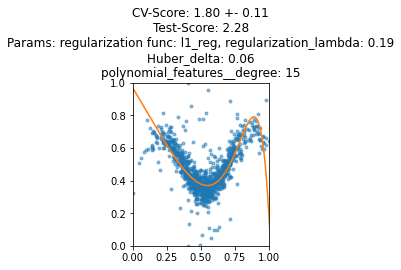

  2%|▏         | 1/50 [00:01<01:19,  1.61s/trial, best loss: 1.8034336219559974]

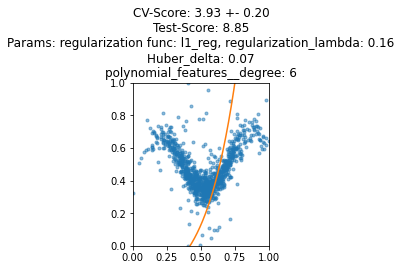

  4%|▍         | 2/50 [00:02<00:55,  1.16s/trial, best loss: 1.8034336219559974]

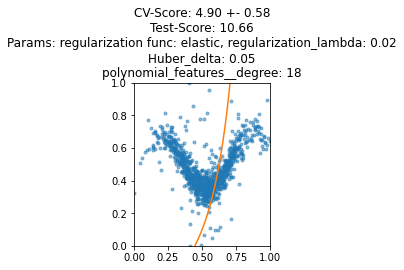

  6%|▌         | 3/50 [00:04<01:03,  1.35s/trial, best loss: 1.8034336219559974]

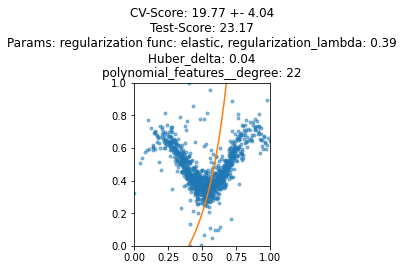

  8%|▊         | 4/50 [00:05<01:11,  1.55s/trial, best loss: 1.8034336219559974]

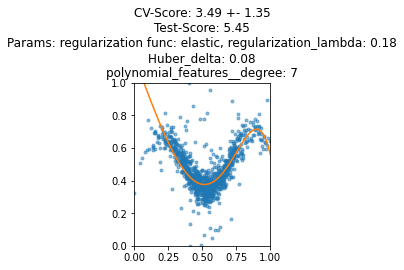

 10%|█         | 5/50 [00:07<01:03,  1.42s/trial, best loss: 1.8034336219559974]

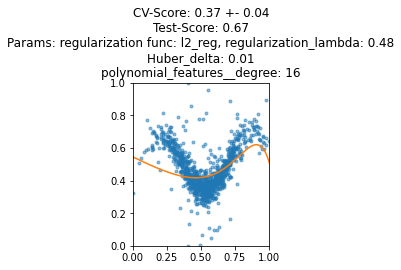

 12%|█▏        | 6/50 [00:08<01:06,  1.51s/trial, best loss: 0.3689554380170611]

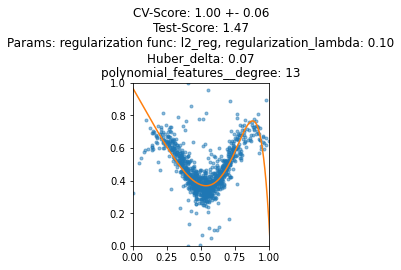

 14%|█▍        | 7/50 [00:10<01:05,  1.52s/trial, best loss: 0.3689554380170611]

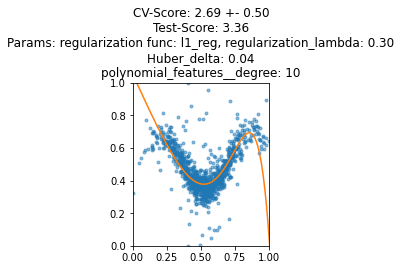

 16%|█▌        | 8/50 [00:11<01:00,  1.44s/trial, best loss: 0.3689554380170611]

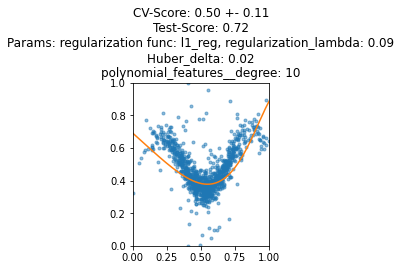

 18%|█▊        | 9/50 [00:12<00:57,  1.39s/trial, best loss: 0.3689554380170611]

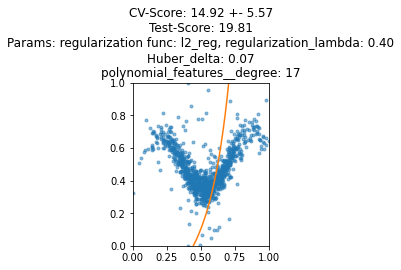

 20%|██        | 10/50 [00:14<00:58,  1.45s/trial, best loss: 0.3689554380170611]

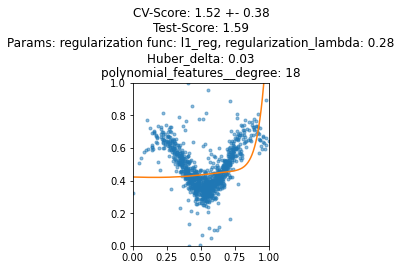

 22%|██▏       | 11/50 [00:17<01:18,  2.01s/trial, best loss: 0.3689554380170611]

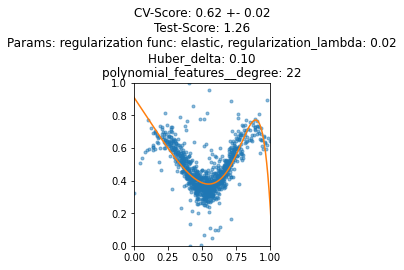

 24%|██▍       | 12/50 [00:20<01:25,  2.25s/trial, best loss: 0.3689554380170611]

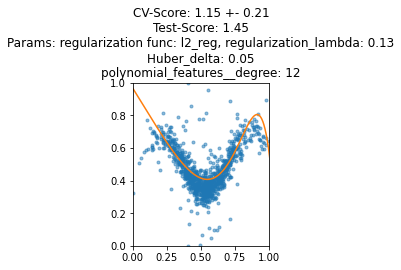

 26%|██▌       | 13/50 [00:21<01:13,  1.98s/trial, best loss: 0.3689554380170611]

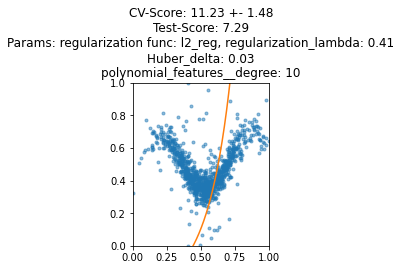

 28%|██▊       | 14/50 [00:22<01:01,  1.70s/trial, best loss: 0.3689554380170611]

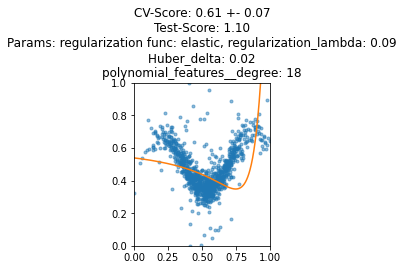

 30%|███       | 15/50 [00:26<01:16,  2.18s/trial, best loss: 0.3689554380170611]

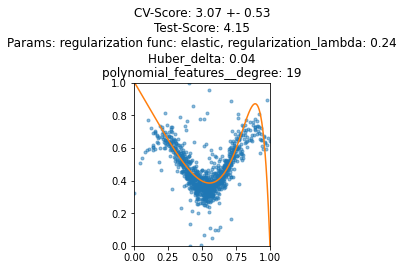

 32%|███▏      | 16/50 [00:28<01:14,  2.18s/trial, best loss: 0.3689554380170611]

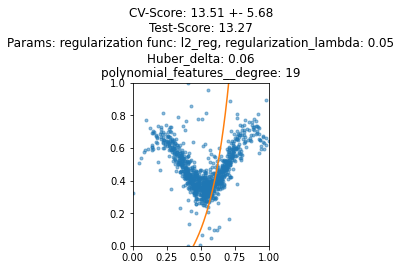

 34%|███▍      | 17/50 [00:30<01:07,  2.03s/trial, best loss: 0.3689554380170611]

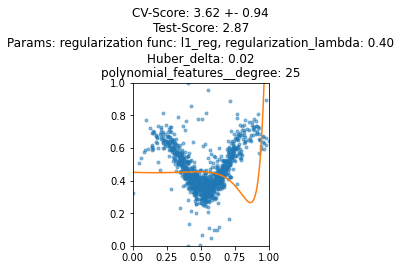

 36%|███▌      | 18/50 [00:34<01:25,  2.67s/trial, best loss: 0.3689554380170611]

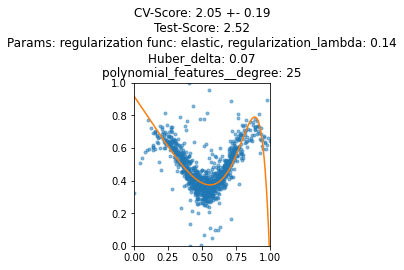

 38%|███▊      | 19/50 [00:37<01:24,  2.74s/trial, best loss: 0.3689554380170611]

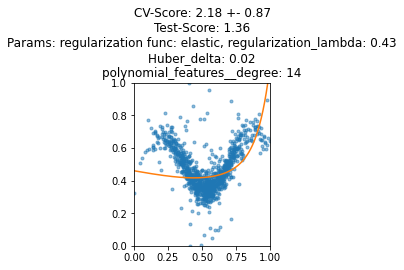

 40%|████      | 20/50 [00:39<01:20,  2.67s/trial, best loss: 0.3689554380170611]

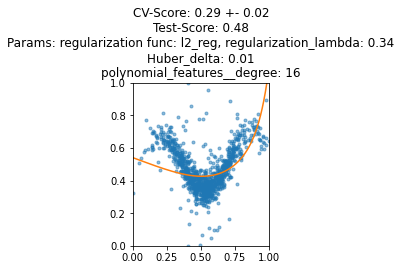

 42%|████▏     | 21/50 [00:41<01:07,  2.33s/trial, best loss: 0.2881808019621267]

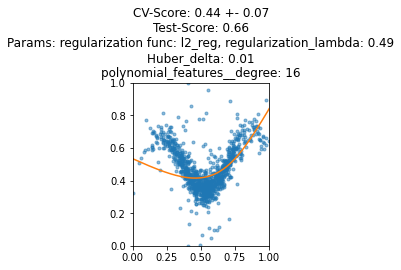

 44%|████▍     | 22/50 [00:43<01:01,  2.18s/trial, best loss: 0.2881808019621267]

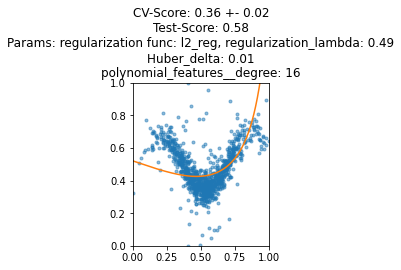

 46%|████▌     | 23/50 [00:44<00:54,  2.02s/trial, best loss: 0.2881808019621267]

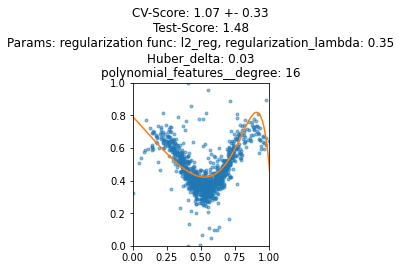

 48%|████▊     | 24/50 [00:46<00:51,  1.97s/trial, best loss: 0.2881808019621267]

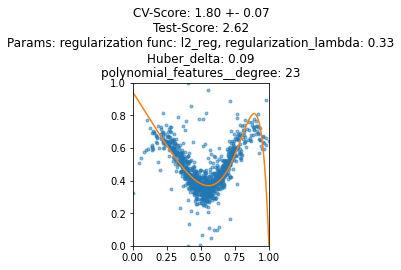

 50%|█████     | 25/50 [00:49<00:55,  2.21s/trial, best loss: 0.2881808019621267]

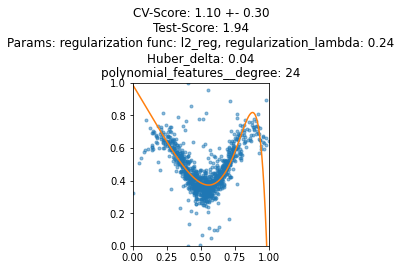

 52%|█████▏    | 26/50 [00:51<00:56,  2.34s/trial, best loss: 0.2881808019621267]

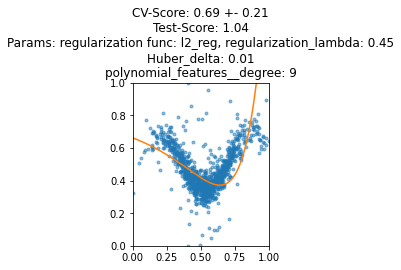

 54%|█████▍    | 27/50 [00:53<00:50,  2.20s/trial, best loss: 0.2881808019621267]

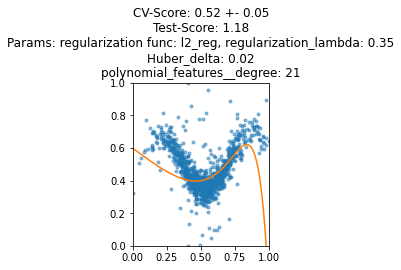

 56%|█████▌    | 28/50 [00:56<00:49,  2.27s/trial, best loss: 0.2881808019621267]

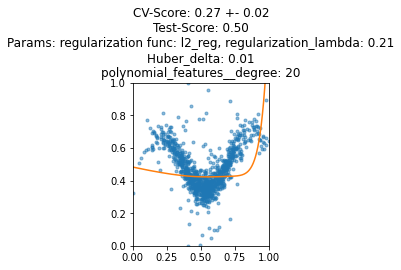

 58%|█████▊    | 29/50 [00:58<00:46,  2.22s/trial, best loss: 0.26771691728369]  

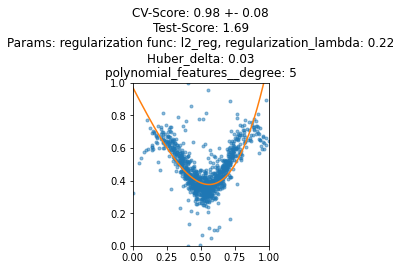

 60%|██████    | 30/50 [00:59<00:37,  1.88s/trial, best loss: 0.26771691728369]

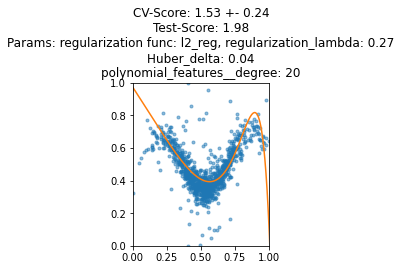

 62%|██████▏   | 31/50 [01:01<00:37,  2.00s/trial, best loss: 0.26771691728369]

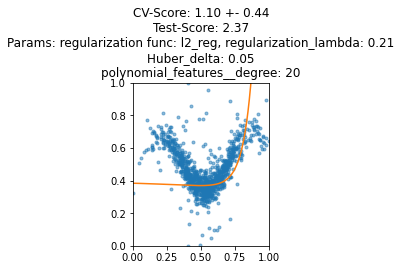

 64%|██████▍   | 32/50 [01:05<00:44,  2.47s/trial, best loss: 0.26771691728369]

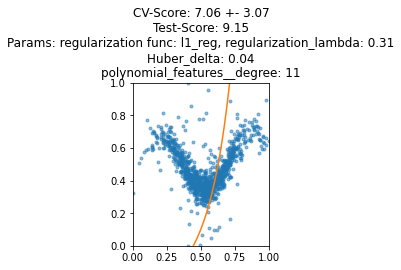

 66%|██████▌   | 33/50 [01:06<00:34,  2.04s/trial, best loss: 0.26771691728369]

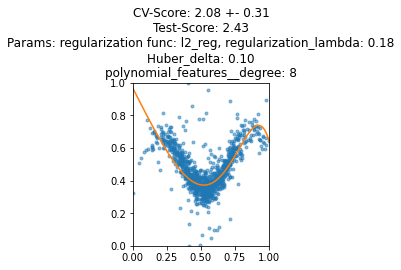

 68%|██████▊   | 34/50 [01:07<00:28,  1.80s/trial, best loss: 0.26771691728369]

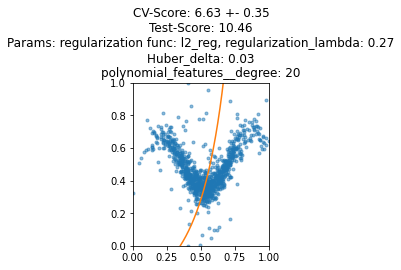

 70%|███████   | 35/50 [01:09<00:26,  1.76s/trial, best loss: 0.26771691728369]

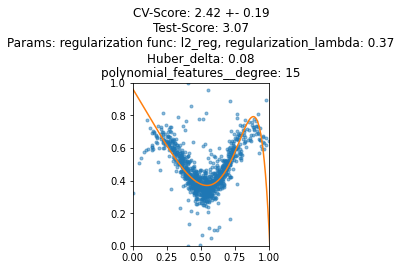

 72%|███████▏  | 36/50 [01:11<00:25,  1.82s/trial, best loss: 0.26771691728369]

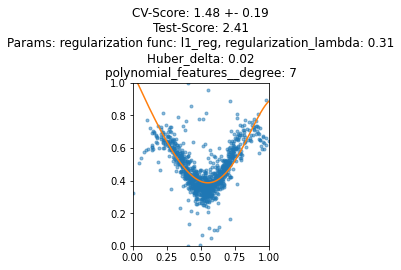

 74%|███████▍  | 37/50 [01:12<00:20,  1.60s/trial, best loss: 0.26771691728369]

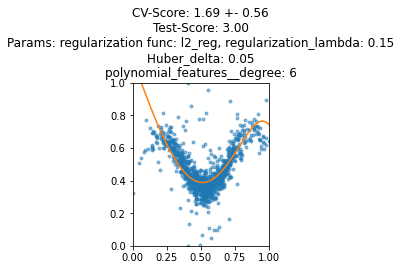

 76%|███████▌  | 38/50 [01:13<00:17,  1.44s/trial, best loss: 0.26771691728369]

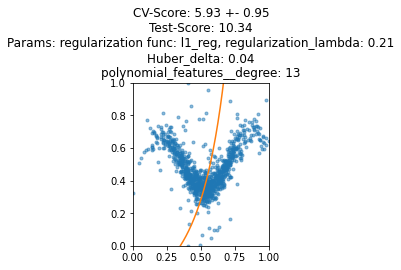

 78%|███████▊  | 39/50 [01:14<00:14,  1.36s/trial, best loss: 0.26771691728369]

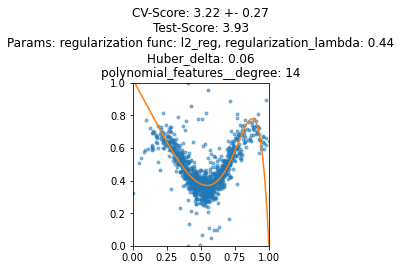

 80%|████████  | 40/50 [01:16<00:14,  1.45s/trial, best loss: 0.26771691728369]

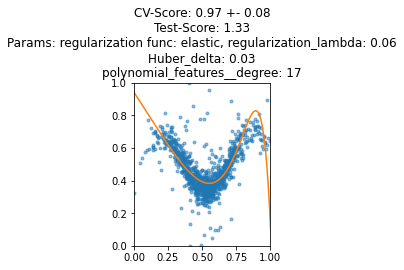

 82%|████████▏ | 41/50 [01:18<00:14,  1.58s/trial, best loss: 0.26771691728369]

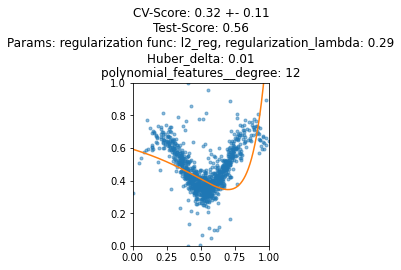

 84%|████████▍ | 42/50 [01:19<00:13,  1.68s/trial, best loss: 0.26771691728369]

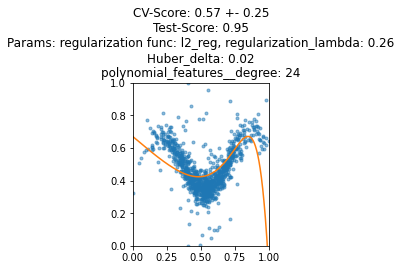

 86%|████████▌ | 43/50 [01:22<00:13,  1.87s/trial, best loss: 0.26771691728369]

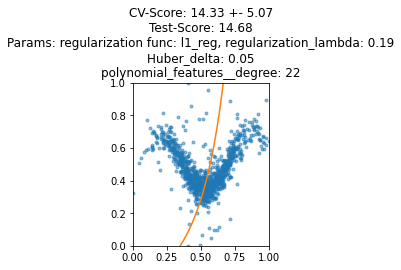

 88%|████████▊ | 44/50 [01:23<00:10,  1.81s/trial, best loss: 0.26771691728369]

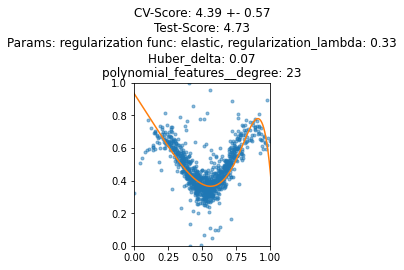

 90%|█████████ | 45/50 [01:26<00:10,  2.11s/trial, best loss: 0.26771691728369]

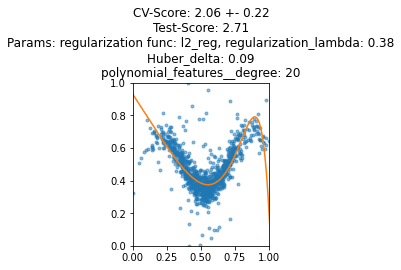

 92%|█████████▏| 46/50 [01:29<00:09,  2.26s/trial, best loss: 0.26771691728369]

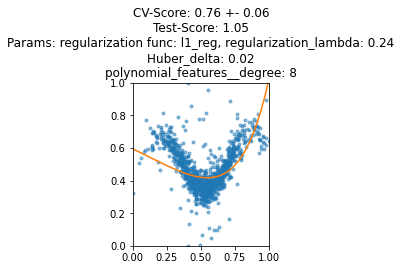

 94%|█████████▍| 47/50 [01:31<00:06,  2.14s/trial, best loss: 0.26771691728369]

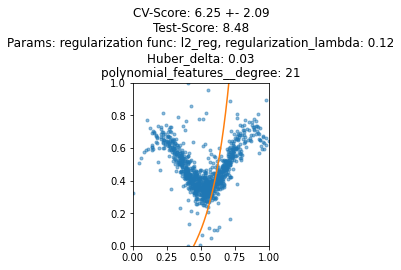

 96%|█████████▌| 48/50 [01:32<00:04,  2.02s/trial, best loss: 0.26771691728369]

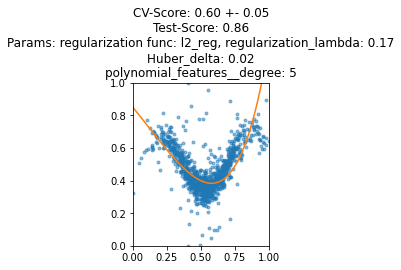

 98%|█████████▊| 49/50 [01:33<00:01,  1.69s/trial, best loss: 0.26771691728369]

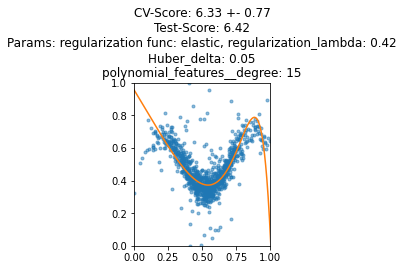

100%|██████████| 50/50 [01:35<00:00,  1.91s/trial, best loss: 0.26771691728369]


In [87]:
trials = Trials()
polynomial_features = PolynomialFeatures(degree = 10) # create instance of transformer
max_evals=50
best_params = fmin( 
            fn=partial(evaluate_metric, X_train=X_train, y_train=y_train,X_test=X_test, y_test = y_test,max_evals=max_evals),
            space=hyper_space,
            algo=tpe.suggest,
            max_evals=max_evals,
            trials=trials,
            rstate=np.random.RandomState(1),
            show_progressbar=True
        )

In [88]:
print(best_params)

{'delta': 0.0109847270258233, 'lam': 0.21498300520499367, 'method_optim': 2, 'polynomial_features__degree': 15, 'regularization function': 1}


Wall time: 22.1 s


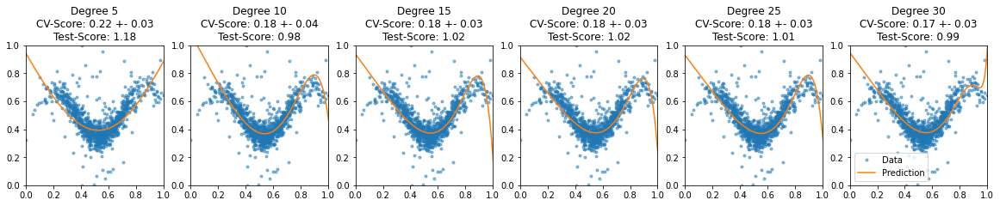

In [94]:
%%time
results = {}
row_results = {}
for i,n in enumerate(degrees):
  polynomial_features = PolynomialFeatures(degree = n) # create instance of transformer
  regression = CustomRegression(loss_function=huber,delta=0.1,method_optim="BFGs") # create instance of model

  # make pipeline as list of pairs (<stage name>, <stage object>):
  pipeline = Pipeline([("polynomial_features", polynomial_features), # augment data
                       ("linear_regression", regression)]) # apply linear regression
  
  # from now we can treat pipeline as a single model, applying all stages when using fit() and predict() 
  pipeline.fit(X_train, y_train)

  # Evaluate pipeline using crossvalidation and score() method
  scores = cross_val_score(pipeline, X_train, y_train, cv=10)
  
  # Make single evaluation on test set
  test_scores = pipeline.score(X_test, y_test)

  # Save results
  results[n] = {'CV_mean':scores.mean(), 'CV_std':scores.std(), 'Test':test_scores}
  row_results[n] = scores

  # Plot results
  line_x = np.linspace(-0.1, 1.1, 1000).reshape(1000,1)
  line_y = pipeline.predict(line_x)
  
  ax = plt.subplot(1, len(degrees), i + 1)
  ax.plot(X, y, '.', alpha = 0.5, label = 'Data')
  ax.autoscale(enable = False)
  ax.plot(line_x, line_y, '-', label = 'Prediction')
  plt.title("Degree %i\nCV-Score: %.2f +- %.2f\nTest-Score: %.2f"%(n, results[n]['CV_mean'],results[n]['CV_std'],results[n]['Test']))
  
plt.legend()

In [95]:
# simple way to see best runs
import pandas as pd
results = pd.DataFrame(results).T
results.style.highlight_min()

,CV_mean,CV_std,Test
5,0.219800,0.026770,1.179789
10,0.180168,0.039827,0.984875
15,0.175614,0.029934,1.015264
20,0.178920,0.027681,1.020454
25,0.180910,0.029096,1.008768
30,0.173031,0.027124,0.994863


<AxesSubplot:>

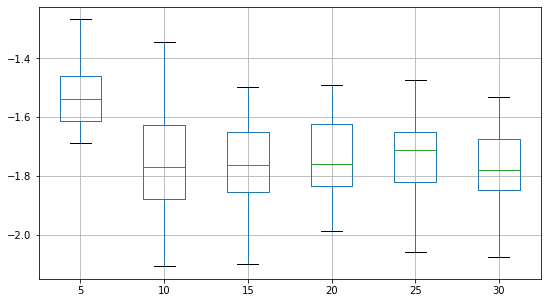

In [96]:
# simple way to visualize model's quality and stability
# using log because of possibly huge outliers on high degrees. Remove it, if everything is  ok.
pd.DataFrame(row_results).apply(np.log).boxplot(figsize = (9,5))

Best model has feature_degree_paramis,which in range(10,25)
BFGs is best optimizer
Huber Loss is good if data has many outliers

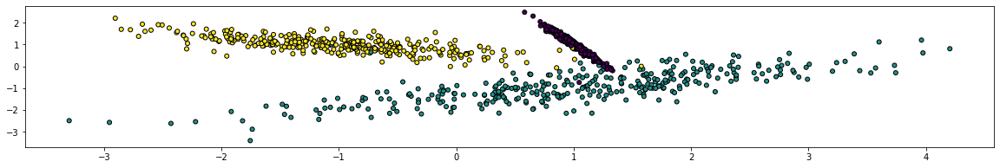

In [353]:
n_samples = 1000
n_outliers = 100

X, y = datasets.make_classification(n_features=2, n_redundant=0, n_informative=2,n_classes=3,
                             n_clusters_per_class=1, n_samples=n_samples)


plt.scatter(X[:, 0], X[:, 1], marker='o', c=y,
            s=25, edgecolor='k')

In [17]:
def one_hot(Y, n_classes):
    one_hot = np.zeros((Y.shape[0], n_classes))
    one_hot[np.arange(Y.size),Y] = 1
    return one_hot.T

In [18]:
def sigmoid(z):
    return 1/(1+np.exp(-z))

def predict(X,theta):
    return sigmoid(np.dot(theta,X.T))

def cross_entropy(y_true,y_pred,n_classes=2):
    y_true=one_hot(y_true,n_classes)
    m = y_true.shape[1] 
    cost=np.sum(y_true*np.log(y_pred)+(1-y_true)*np.log(1-y_pred))/-m
    return cost

def objective_function(theta, X,y, loss_function=cross_entropy, n_classes=2, regularization = None, lam = 1/2):
    theta=np.array(theta).reshape(n_classes,X.shape[1])
    y_pred = predict(X, theta)
    if regularization:
        return loss_function(y, y_pred,n_classes) + regularization(theta,lam)
    else:
        return loss_function(y, y_pred,n_classes)
        

In [19]:
# For further use, let's make universal function to train regression model with any objective and loss functions

def custom_classification(X, y, 
                      objective_function=objective_function, 
                      loss_function=cross_entropy,
                      regularization=None,
                      n_classes=2,
                      lam=1/2,
                      verbose = True, 
                      iters = 20,
                      method_optim = 'CG'
                      ):
  
  theta_init = np.ones((n_classes,X.shape[1]))
  result = optimize.minimize(objective_function,
                             args=(X, y, loss_function,n_classes,regularization,lam), 
                             x0 = theta_init, 
                             method=method_optim, 
                             options={'maxiter': iters})
  theta = result['x']
  if verbose:
    print(result['fun'])
  return theta

In [20]:
class CustomClassification(BaseEstimator, ClassifierMixin):                           
    def __init__(self, loss_function=cross_entropy, objective_function=objective_function,reguralization=None,lam=1/2, n_classes = 2,verbose=True,method_optim = 'CG'): 
        self.theta = None 
        self.loss_function = loss_function 
        self.objective_function = objective_function
        self.reguralization = reguralization
        self.lam=lam
        self.method_optim=method_optim
        self.n_classes = n_classes
        self.verbose=verbose

    def predict(self, X):
        self.theta=self.theta.reshape(self.n_classes,X.shape[1])
        return np.argmax(predict(X, self.theta),axis=0).T
    
    def score(self, X, y):
        return self.objective_function(theta=self.theta, X=X,y=y,loss_function=self.loss_function,n_classes=self.n_classes,regularization = self.reguralization,lam=self.lam)
    
    def fit(self, X, y):
        np.ones((self.n_classes,X.shape[1]))
        self.theta = custom_classification(X, y, self.objective_function, self.loss_function, regularization=self.reguralization,n_classes=self.n_classes, verbose = self.verbose,lam=self.lam,method_optim=self.method_optim)
        return self.score(X, y)
    
    def fit_predict(self, X, y):
        self.fit(X,y)
        return self.predict(X)
        

In [21]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33)

In [23]:
def evaluate_metric(params,X_train,y_train,X_test, y_test,max_evals):
    classifier = CustomClassification(loss_function=cross_entropy,n_classes=3)
    classifier.set_params(**params)
    classifier.fit(X_train, y_train)
    kf = KFold(n_splits=5, shuffle=True, random_state=1)
    scores = cross_val_score(classifier, X_train, y_train, cv=kf)
    test_scores = classifier.score(X_test, y_test)
    predictions = classifier.predict(X_test)
    plt.figure(figsize=(8, 8))
    plt.subplot(321)
    plt.title(f"Y_TRUE", fontsize='small')
    plt.scatter(X_test[:, 0], X_test[:, 1], marker='o', c=y_test,
            s=25, edgecolor='k')
    plt.subplot(322)
    plt.title(f"Prediction\nparams: optimization {classifier.get_params()['method_optim']}\nregularization {classifier.get_params()['reguralization']}", fontsize='small')
    plt.scatter(X_test[:, 0], X_test[:, 1], marker='o', c=predictions,
            s=25, edgecolor='k')       
    plt.show()
    return  {'loss': test_scores.mean(), 'params': params,'status': STATUS_OK}

In [24]:
hyper_space = {
               'reguralization':  hp.choice('regularization function', [l1_reg,l2_reg,elastic]),
               'lam': hp.uniform('lam', 1e-4, 1/2),
               'method_optim': hp.choice('method_optim', ['CG','TNC','BFGS','Powell'])
               }

2.0389299618405197
2.0885477276596616
2.0797279103805035
2.0452334406496306
2.061824235833611
2.0927932704307666
  0%|          | 0/20 [00:00<?, ?trial/s, best loss=?]

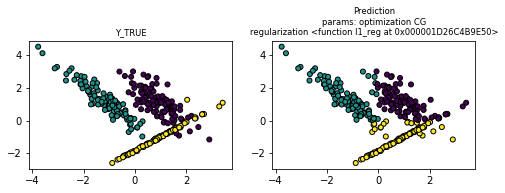

2.024337484070592
2.082629687799994
2.3403064641270426
3.420577539305062
2.9496501657259135
  5%|▌         | 1/20 [00:01<00:20,  1.08s/trial, best loss: 2.014658298810936]<ipython-input-18-05de95a5b2fe>:10: RuntimeWarning: divide by zero encountered in log
  cost=np.sum(y_true*np.log(y_pred)+(1-y_true)*np.log(1-y_pred))/-m

C:\Users\rodion\AppData\Local\Programs\Python\Python38\lib\site-packages\scipy\optimize\_numdiff.py:557: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0

1.9923756006848556
  5%|▌         | 1/20 [00:01<00:20,  1.08s/trial, best loss: 2.014658298810936]

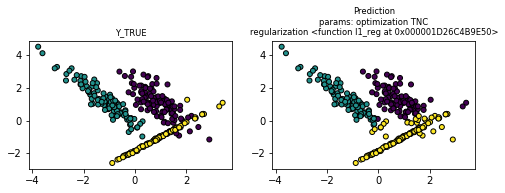

2.026276791077624
1.960781855988638
2.5795852163182063
2.404336510475669
2.0561828277518237
2.0422984422511794
 10%|█         | 2/20 [00:02<00:17,  1.05trial/s, best loss: 1.9790883627198301]

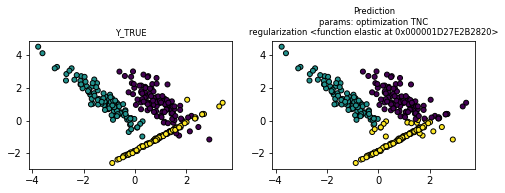

1.2958717361249112
1.2859670853818985
1.3507766432834583
1.2571393780576128
1.2743485645452401
1.4944464361826324
 15%|█▌        | 3/20 [00:03<00:15,  1.08trial/s, best loss: 1.9790883627198301]

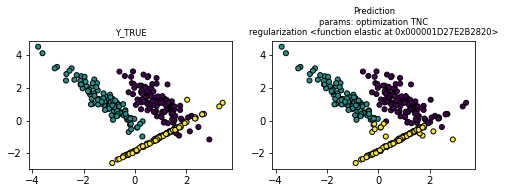

1.9788924380614479
1.9851645736521168
1.9804732078339713
1.974579261321975
1.9772954567164418
1.9770912125979687
 20%|██        | 4/20 [00:05<00:14,  1.08trial/s, best loss: 1.2017215757378366]

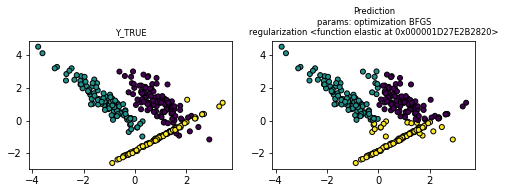

1.7042147657202174
1.7106316876171346
1.7092058230066483
1.6953493223732186
1.7029630274540308
1.701858515756538
 25%|██▌       | 5/20 [00:06<00:20,  1.33s/trial, best loss: 1.2017215757378366]

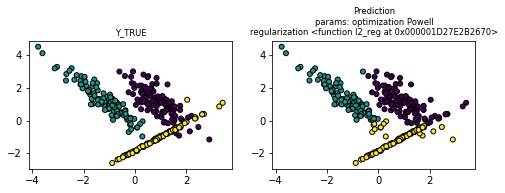

1.7377807783397428
1.743988342104433
1.742575842682918
1.7294954704711594
1.7365208359994624
1.7353438963810146
 30%|███       | 6/20 [00:07<00:16,  1.19s/trial, best loss: 1.2017215757378366]

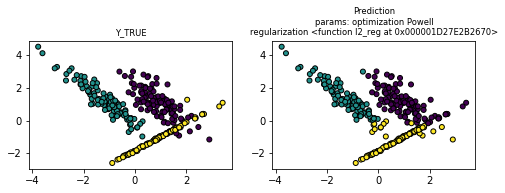

1.4277596135449753
1.4395083582979116
1.449761841775825
1.4115439412689708
1.426357822138495
1.4274137297614045
 35%|███▌      | 7/20 [00:08<00:15,  1.17s/trial, best loss: 1.2017215757378366]

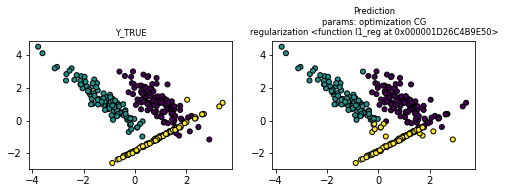

3.510260978167349
3.1470872418670917
2.268381606252786
2.2540942899348297
2.3829441499598127
2.2723999698182302
 40%|████      | 8/20 [00:09<00:16,  1.35s/trial, best loss: 1.2017215757378366]<ipython-input-18-05de95a5b2fe>:10: RuntimeWarning: divide by zero encountered in log
  cost=np.sum(y_true*np.log(y_pred)+(1-y_true)*np.log(1-y_pred))/-m

C:\Users\rodion\AppData\Local\Programs\Python\Python38\lib\site-packages\scipy\optimize\_numdiff.py:557: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0



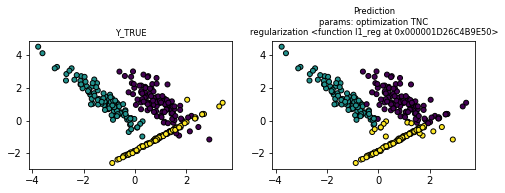

1.7706577810950128
1.7766186196212057
1.7752235112881314
1.762963834417269
1.7694056856680647
1.7681790811236455
 45%|████▌     | 9/20 [00:10<00:14,  1.30s/trial, best loss: 1.2017215757378366]

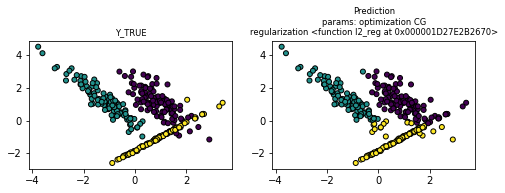

2.083609390270028
3.6434212010219253
4.357207429750686
2.125596788343178
3.7595564467325038
2.8567609927574327
 50%|█████     | 10/20 [00:12<00:11,  1.20s/trial, best loss: 1.2017215757378366]<ipython-input-18-05de95a5b2fe>:10: RuntimeWarning: divide by zero encountered in log
  cost=np.sum(y_true*np.log(y_pred)+(1-y_true)*np.log(1-y_pred))/-m

C:\Users\rodion\AppData\Local\Programs\Python\Python38\lib\site-packages\scipy\optimize\_numdiff.py:557: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0

<ipython-input-18-05de95a5b2fe>:10: RuntimeWarning: divide by zero encountered in log
  cost=np.sum(y_true*np.log(y_pred)+(1-y_true)*np.log(1-y_pred))/-m

<ipython-input-18-05de95a5b2fe>:10: RuntimeWarning: invalid value encountered in multiply
  cost=np.sum(y_true*np.log(y_pred)+(1-y_true)*np.log(1-y_pred))/-m



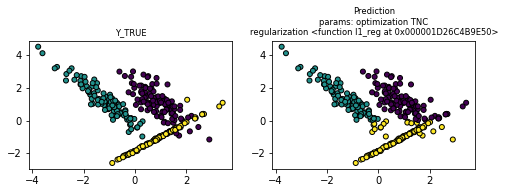

1.83447107084283
2.0068185662939606
1.8546555090392047
1.8380689720226746
1.8790334940499758
1.8468699843626808
 55%|█████▌    | 11/20 [00:13<00:10,  1.16s/trial, best loss: 1.2017215757378366]

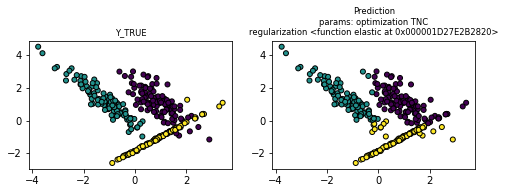

1.8550552424809004
1.8601371676147558
1.8588469503223843
1.849019388343083
1.8539069076403616
1.8526711896766466
 60%|██████    | 12/20 [00:14<00:09,  1.15s/trial, best loss: 1.2017215757378366]

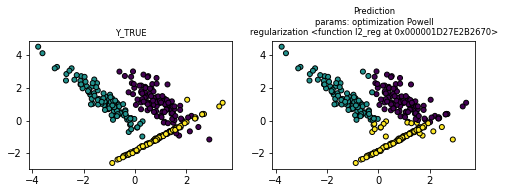

2.5038418685743817
2.1803119010136767
1.9001014481909897
1.6471588707462386
1.6698679024055962
1.7252914887455668
 65%|██████▌   | 13/20 [00:15<00:07,  1.11s/trial, best loss: 1.2017215757378366]<ipython-input-18-05de95a5b2fe>:10: RuntimeWarning: divide by zero encountered in log
  cost=np.sum(y_true*np.log(y_pred)+(1-y_true)*np.log(1-y_pred))/-m

<ipython-input-18-05de95a5b2fe>:10: RuntimeWarning: invalid value encountered in multiply
  cost=np.sum(y_true*np.log(y_pred)+(1-y_true)*np.log(1-y_pred))/-m



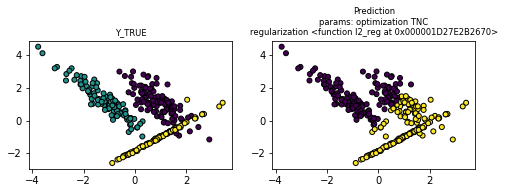

2.006640837945616
2.011870801114408
2.008002428483932
2.0027232785131823
2.00524569581499
2.005129517322022
 70%|███████   | 14/20 [00:16<00:06,  1.05s/trial, best loss: 1.2017215757378366]

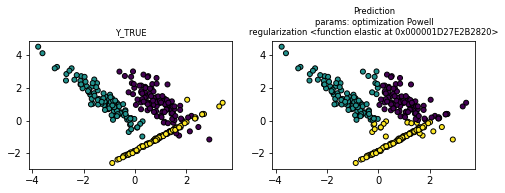

2.0775527510599976
2.079164437966748
2.077785117525772
2.07690531720854
2.077322888660583
2.0789250261069725
 75%|███████▌  | 15/20 [00:18<00:05,  1.07s/trial, best loss: 1.2017215757378366]

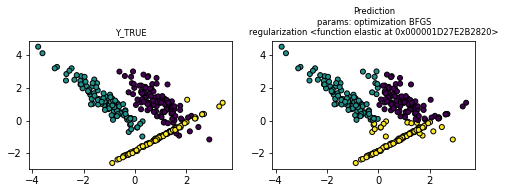

1.753708716276675
1.759802383460931
1.7583974114383676
1.7457067403471054
1.7524505239143815
1.7512467067578903
 80%|████████  | 16/20 [00:18<00:05,  1.26s/trial, best loss: 1.2017215757378366]

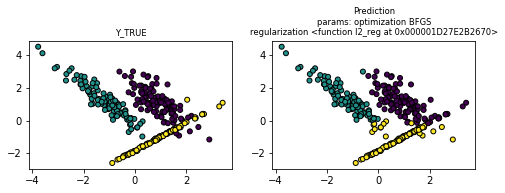

1.8009274454717052
1.8118519349577384
1.8050125434474142
1.8191886352732585
1.8022382580213328
1.8023957815660663
 85%|████████▌ | 17/20 [00:20<00:03,  1.13s/trial, best loss: 1.2017215757378366]

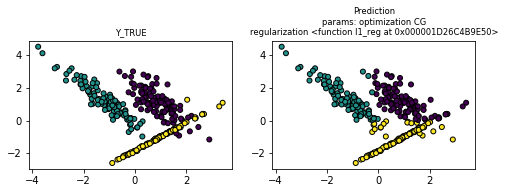

2.7848940215610267
3.1384645797791926
5.79178189865619
2.1528076361202357
2.4142214056426488
2.2148649436316514
 90%|█████████ | 18/20 [00:21<00:02,  1.35s/trial, best loss: 1.2017215757378366]<ipython-input-18-05de95a5b2fe>:10: RuntimeWarning: divide by zero encountered in log
  cost=np.sum(y_true*np.log(y_pred)+(1-y_true)*np.log(1-y_pred))/-m

C:\Users\rodion\AppData\Local\Programs\Python\Python38\lib\site-packages\scipy\optimize\_numdiff.py:557: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0



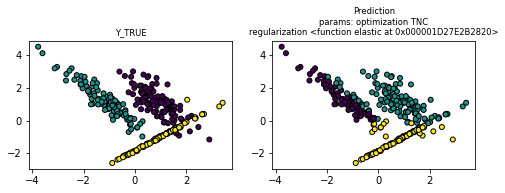

2.077137821828458
2.0837521732795263
2.0759358833772237
2.081530977248813
2.0845394139036277
2.0922732543881026
 95%|█████████▌| 19/20 [00:22<00:01,  1.21s/trial, best loss: 1.2017215757378366]

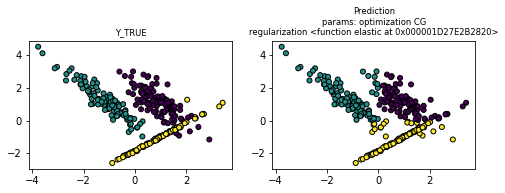

100%|██████████| 20/20 [00:23<00:00,  1.19s/trial, best loss: 1.2017215757378366]


In [25]:
trials = Trials()
max_evals=20
best_params = fmin( 
            fn=partial(evaluate_metric, X_train=X_train, y_train=y_train,X_test=X_test, y_test = y_test,max_evals=max_evals),
            space=hyper_space,
            algo=tpe.suggest,
            max_evals=max_evals,
            trials=trials,
            rstate=np.random.RandomState(1),
            show_progressbar=True
        )

Best parameters for logistic regression: optimizator: BFGS, elasticnet regularizator